In [ ]:
%run functions_analysis.ipynb

In [194]:
## Image
background_image = 'big.png'
img = mpimg.imread(background_image)
disp_h, disp_w, dim = np.shape(img)


#Gaussian heatmap
alpha = 0.5
ngaussian = 200 
sd = 50

## Files data
file1 ='C:\\Users\\David\\Desktop\\OpenBrains\\big2_david.txt'
file2 ='C:\\Users\\David\\Desktop\\OpenBrains\\big2_players.txt'
file3 ='C:\\Users\\David\\Desktop\\OpenBrains\\big3_borders.txt'

In [ ]:
## File 1

#Load and get data
data = pd.read_csv(file3, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)



In [186]:
## Image
background_image = 'big.png'
img = mpimg.imread(background_image)
disp_h, disp_w, dim = np.shape(img)


#Gaussian heatmap
alpha = 0.5
ngaussian = 200 
sd = 50


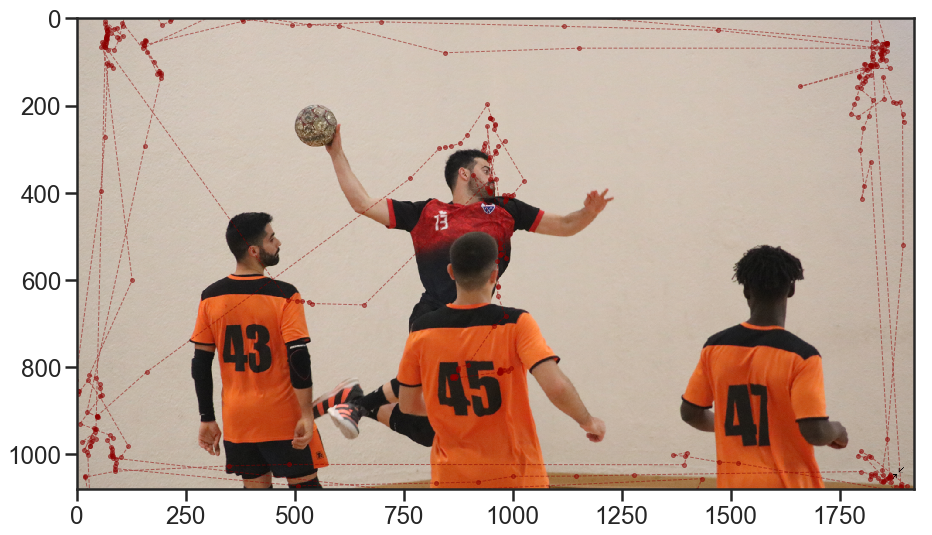

In [187]:
## File 1

#Load and get data
data = pd.read_csv(file3, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)



img = mpimg.imread('big.png')
plt.figure(figsize=(15,10))
imgplot = plt.imshow(img)
plt.ylim(disp_h,0)
plt.xlim(0, disp_w)
plt.plot(df.x, df.y, '--', color='darkred', alpha=0.5, marker='o', linewidth=1, markersize=4)

In [188]:

def gaussian(x, sx, y=None, sy=None):
    """Returns an array of numpy arrays (a matrix) containing values between
    1 and 0 in a 2D Gaussian distribution

    arguments
    x		-- width in pixels
    sx		-- width standard deviation

    keyword argments
    y		-- height in pixels (default = x)
    sy		-- height standard deviation (default = sx)
    """

    # square Gaussian if only x values are passed
    if y == None:
        y = x
    if sy == None:
        sy = sx
    # centers
    xo = x / 2
    yo = y / 2
    # matrix of zeros
    M = numpy.zeros([x, y], dtype=float)
    # gaussian matrix
    for i in range(y):
        for j in range(x):
            M[j, i] = numpy.exp(
                -1.0 * (((float(i) - xo) ** 2 / (2 * sx * sx)) + ((float(j) - yo) ** 2 / (2 * sy * sy))))

    return M



def draw_display(dispsize, imagefile=None):
    """Returns a matplotlib.pyplot Figure and its axes, with a size of
    dispsize, a black background colour, and optionally with an image drawn
    onto it

    arguments

    dispsize		-	tuple or list indicating the size of the display,
                    e.g. (1024,768)

    keyword arguments

    imagefile		-	full path to an image file over which the heatmap
                    is to be laid, or None for no image; NOTE: the image
                    may be smaller than the display size, the function
                    assumes that the image was presented at the centre of
                    the display (default = None)

    returns
    fig, ax		-	matplotlib.pyplot Figure and its axes: field of zeros
                    with a size of dispsize, and an image drawn onto it
                    if an imagefile was passed
    """

    # construct screen (black background)
    screen = numpy.zeros((dispsize[1], dispsize[0], 3), dtype='float32')
    # if an image location has been passed, draw the image
    if imagefile != None:
        # check if the path to the image exists
        if not os.path.isfile(imagefile):
            raise Exception("ERROR in draw_display: imagefile not found at '%s'" % imagefile)
        # load image
        img = mpimg.imread(imagefile)
        #img = image.imread(imagefile)

        # width and height of the image
        w, h = len(img[0]), len(img)
        # x and y position of the image on the display
        x = dispsize[0] / 2 - w / 2
        y = dispsize[1] / 2 - h / 2
        # draw the image on the screen
        screen[int(y):int(y) + h, int(x):int(x) + w, :] += img
    # dots per inch
    dpi = 100.0
    # determine the figure size in inches
    figsize = (dispsize[0] / dpi, dispsize[1] / dpi)
    # create a figure
    fig = pyplot.figure(figsize=figsize, dpi=dpi, frameon=False)
    ax = pyplot.Axes(fig, [0, 0, 1, 1])
    ax.set_axis_off()
    fig.add_axes(ax)
    # plot display
    ax.axis([0, dispsize[0], 0, dispsize[1]])
    ax.imshow(screen)  # , origin='upper')

    return fig, ax



In [189]:
df_gazepoints = df
dispsize = (disp_w, disp_h)
imagefile=background_image
alpha=0.5
savefilename=None
gaussianwh=ngaussian
plot_xy=True
gaussiansd=sd

In [190]:

def fixations_heatmap(df_gazepoints, dispsize, imagefile=None, alpha=0.5, savefilename=None, 
                 gaussianwh=200, plot_xy=False, gaussiansd=None):
    """Draws a heatmap of the provided fixations, optionally drawn over an
    image, and optionally allocating more weight to fixations with a higher
    duration.

    arguments

    gazepoints		-	a list of gazepoint tuples (x, y)
    
    dispsize		-	tuple or list indicating the size of the display,
                    e.g. (1024,768)

    keyword arguments

    imagefile		-	full path to an image file over which the heatmap
                    is to be laid, or None for no image; NOTE: the image
                    may be smaller than the display size, the function
                    assumes that the image was presented at the centre of
                    the display (default = None)
    alpha		-	float between 0 and 1, indicating the transparancy of
                    the heatmap, where 0 is completely transparant and 1
                    is completely untransparant (default = 0.5)
    savefilename	-	full path to the file in which the heatmap should be
                    saved, or None to not save the file (default = None)

    returns

    fig			-	a matplotlib.pyplot Figure instance, containing the
                    heatmap
    """
    
    ###
    gwh = gaussianwh
    gsdwh = gwh / 6 if (gaussiansd is None) else gaussiansd
    #
    # matrix of zeroes
    strt = gwh / 2
    heatmapsize = (dispsize[0], dispsize[1])
    heatmap = numpy.zeros(heatmapsize, dtype=float)
    #
    gazepoints = [(df_gazepoints.X.iloc[i], df_gazepoints.Y.iloc[i]) for i in range(len(df_gazepoints))]    
    gaus_standard = gaussian(x=gwh, y=gwh, sx=gsdwh) 
    ###
    for i in range(0, len(gazepoints)):
        # get x and y coordinates
        x =  gazepoints[i][0] 
        #print(x)
        y =  gazepoints[i][1] 
        # add Gaussian to the current heatmap
        ####
        ####
        if (x>0) and (y>0):
            x_inf = x - (gwh/2)
            x_sup = x + (gwh/2)
            y_inf = y - (gwh/2)
            y_sup = y + (gwh/2)
            ####
            ####
            if x_inf<0:
                x_inf=0
            if x_sup>dispsize[0]:
                x_sup = dispsize[0]
            if y_inf<0:
                y_inf=0
            if y_sup>dispsize[1]:
                y_sup = dispsize[1]
            ####
            ####
            y_inf=int(y_inf)
            y_sup=int(y_sup)
            x_inf=int(x_inf)
            x_sup=int(x_sup)
            ##
            shape_gauss = (x_sup-x_inf, y_sup-y_inf)
            if shape_gauss==(gwh, gwh):
                gaus = gaus_standard
                heatmap[x_inf:x_sup, y_inf:y_sup ] += gaus
            else:
                gaus = gaussian(x=x_sup-x_inf, y=y_sup-y_inf, sx=gsdwh)
                heatmap[x_inf:x_sup, y_inf:y_sup ] += gaus

            #heatmap[y_inf:y_sup, x_inf:x_sup ] += gaus
            ###
        ###
    ###
    ###
    ###
    heatmap_low = heatmap.copy()
    fig, ax = draw_display(dispsize, imagefile=imagefile)
    lowbound = numpy.mean(heatmap[heatmap > 0])
    heatmap_low[heatmap_low < lowbound] = numpy.NaN
    # draw heatmap on top of image
    ax.imshow(heatmap_low.T, cmap='jet', alpha=alpha) #, origin="lower")
    if plot_xy ==True:
        plt.plot(df_gazepoints.X, df_gazepoints.Y, '--', color='darkred', alpha=0.5, marker='o', linewidth=1, markersize=4)
    # FINISH PLOT
    # invert the y axis, as (0,0) is top left on a display
    ax.invert_yaxis()
    ###
    if savefilename != None:
        fig.savefig(savefilename)
    ###
    
    


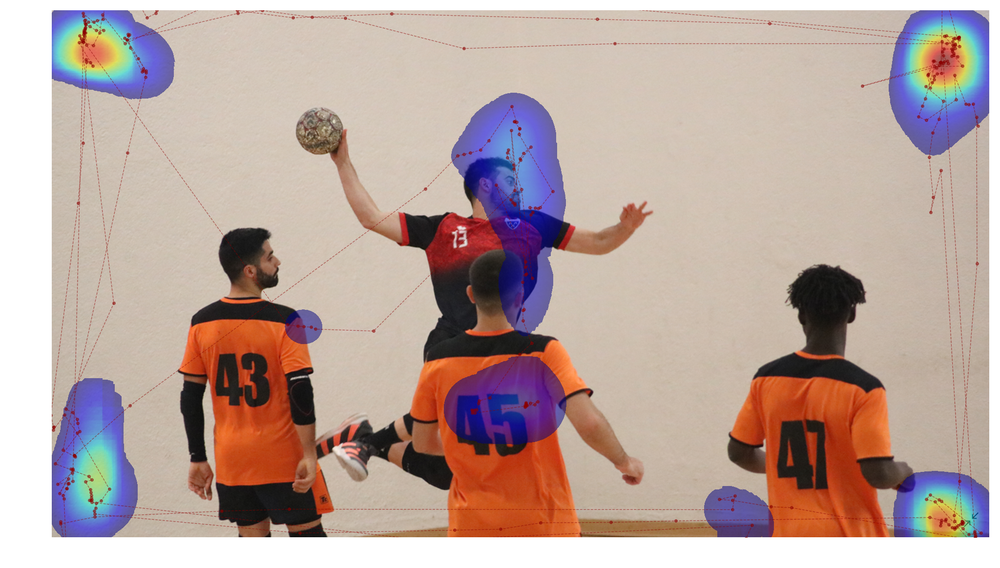

In [191]:
fixations_heatmap(df, (disp_w, disp_h), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)

In [192]:
%run functions_analysis.ipynb

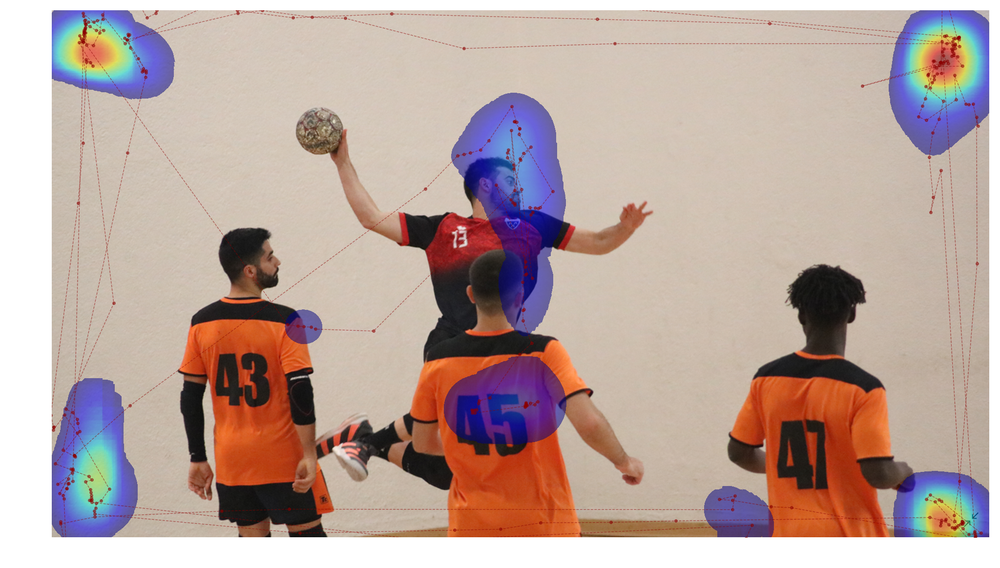

In [193]:
fixations_heatmap(df, (disp_w, disp_h), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)

In [178]:
%run functions_analysis.ipynb

In [179]:
## Image
background_image = 'big.png'
img = mpimg.imread(background_image)
disp_h, disp_w, dim = np.shape(img)


#Gaussian heatmap
alpha = 0.5
ngaussian = 200 
sd = 50

## Files data
file1 ='C:\\Users\\David\\Desktop\\OpenBrains\\big2_david.txt'
file2 ='C:\\Users\\David\\Desktop\\OpenBrains\\big2_players.txt'
file3 ='C:\\Users\\David\\Desktop\\OpenBrains\\big3_borders.txt'

In [185]:
## File 1

#Load and get data
data = pd.read_csv(file1, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)

##

fixations_heatmap(df, (disp_w, disp_h), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)

ValueError: negative dimensions are not allowed

In [1]:
%run functions_heatmap.ipynb

In [162]:
## Image
background_image = 'big.png'
img = mpimg.imread(background_image)
disp_h, disp_w, dim = np.shape(img)


#Gaussian heatmap
alpha = 0.5
ngaussian = 200 
sd = 50

## Files data
file1 ='C:\\Users\\David\\Desktop\\OpenBrains\\big2_david.txt'
file2 ='C:\\Users\\David\\Desktop\\OpenBrains\\big2_players.txt'
file3 ='C:\\Users\\David\\Desktop\\OpenBrains\\big3_borders.txt'


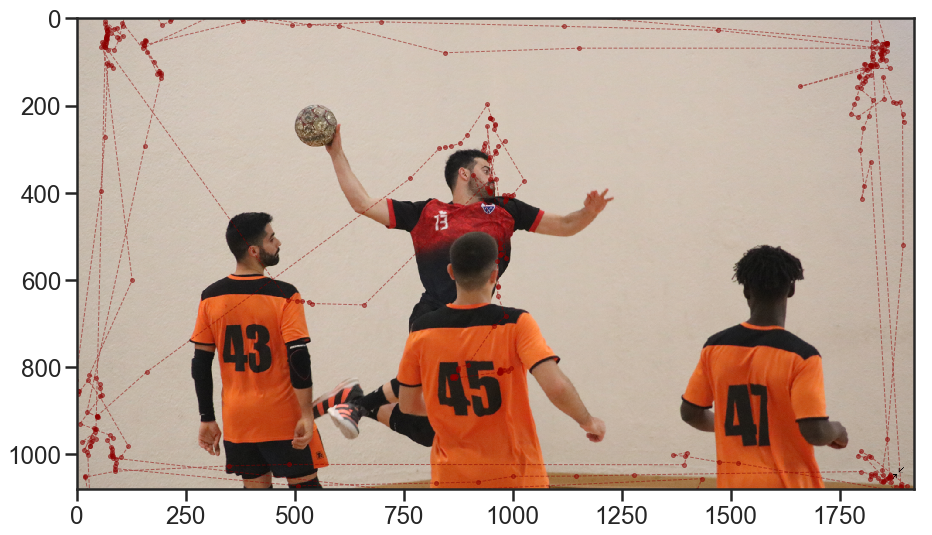

In [163]:
## File 1

#Load and get data
data = pd.read_csv(file3, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)



img = mpimg.imread('big.png')
plt.figure(figsize=(15,10))
imgplot = plt.imshow(img)
plt.ylim(disp_h,0)
plt.xlim(0, disp_w)
plt.plot(df.x, df.y, '--', color='darkred', alpha=0.5, marker='o', linewidth=1, markersize=4)

In [181]:

def gaussian(x, sx, y=None, sy=None):
    """Returns an array of numpy arrays (a matrix) containing values between
    1 and 0 in a 2D Gaussian distribution

    arguments
    x		-- width in pixels
    sx		-- width standard deviation

    keyword argments
    y		-- height in pixels (default = x)
    sy		-- height standard deviation (default = sx)
    """

    # square Gaussian if only x values are passed
    if y == None:
        y = x
    if sy == None:
        sy = sx
    # centers
    xo = x / 2
    yo = y / 2
    # matrix of zeros
    M = numpy.zeros([x, y], dtype=float)
    # gaussian matrix
    for i in range(y):
        for j in range(x):
            M[j, i] = numpy.exp(
                -1.0 * (((float(i) - xo) ** 2 / (2 * sx * sx)) + ((float(j) - yo) ** 2 / (2 * sy * sy))))

    return M



def draw_display(dispsize, imagefile=None):
    """Returns a matplotlib.pyplot Figure and its axes, with a size of
    dispsize, a black background colour, and optionally with an image drawn
    onto it

    arguments

    dispsize		-	tuple or list indicating the size of the display,
                    e.g. (1024,768)

    keyword arguments

    imagefile		-	full path to an image file over which the heatmap
                    is to be laid, or None for no image; NOTE: the image
                    may be smaller than the display size, the function
                    assumes that the image was presented at the centre of
                    the display (default = None)

    returns
    fig, ax		-	matplotlib.pyplot Figure and its axes: field of zeros
                    with a size of dispsize, and an image drawn onto it
                    if an imagefile was passed
    """

    # construct screen (black background)
    screen = numpy.zeros((dispsize[1], dispsize[0], 3), dtype='float32')
    # if an image location has been passed, draw the image
    if imagefile != None:
        # check if the path to the image exists
        if not os.path.isfile(imagefile):
            raise Exception("ERROR in draw_display: imagefile not found at '%s'" % imagefile)
        # load image
        img = mpimg.imread(imagefile)
        #img = image.imread(imagefile)

        # width and height of the image
        w, h = len(img[0]), len(img)
        # x and y position of the image on the display
        x = dispsize[0] / 2 - w / 2
        y = dispsize[1] / 2 - h / 2
        # draw the image on the screen
        screen[int(y):int(y) + h, int(x):int(x) + w, :] += img
    # dots per inch
    dpi = 100.0
    # determine the figure size in inches
    figsize = (dispsize[0] / dpi, dispsize[1] / dpi)
    # create a figure
    fig = pyplot.figure(figsize=figsize, dpi=dpi, frameon=False)
    ax = pyplot.Axes(fig, [0, 0, 1, 1])
    ax.set_axis_off()
    fig.add_axes(ax)
    # plot display
    ax.axis([0, dispsize[0], 0, dispsize[1]])
    ax.imshow(screen)  # , origin='upper')

    return fig, ax



In [165]:
df_gazepoints = df
dispsize = (disp_w, disp_h)
imagefile=background_image
alpha=0.5
savefilename=None
gaussianwh=ngaussian
plot_xy=True
gaussiansd=sd

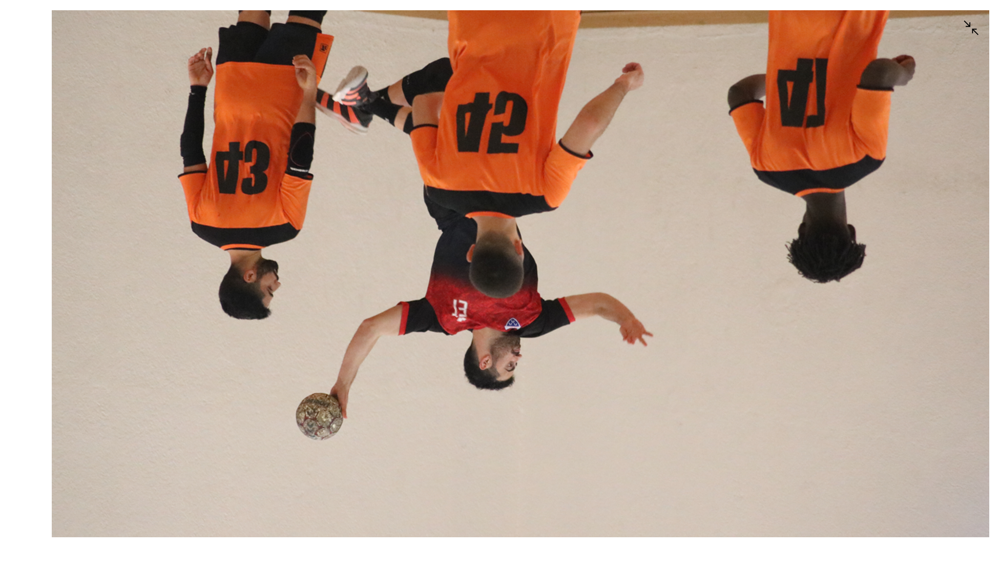

In [166]:
fig, ax = draw_display(dispsize, imagefile=imagefile);

In [184]:

def fixations_heatmap(df_gazepoints, dispsize, imagefile=None, alpha=0.5, savefilename=None, 
                 gaussianwh=200, plot_xy=False, gaussiansd=None):
    """Draws a heatmap of the provided fixations, optionally drawn over an
    image, and optionally allocating more weight to fixations with a higher
    duration.

    arguments

    gazepoints		-	a list of gazepoint tuples (x, y)
    
    dispsize		-	tuple or list indicating the size of the display,
                    e.g. (1024,768)

    keyword arguments

    imagefile		-	full path to an image file over which the heatmap
                    is to be laid, or None for no image; NOTE: the image
                    may be smaller than the display size, the function
                    assumes that the image was presented at the centre of
                    the display (default = None)
    alpha		-	float between 0 and 1, indicating the transparancy of
                    the heatmap, where 0 is completely transparant and 1
                    is completely untransparant (default = 0.5)
    savefilename	-	full path to the file in which the heatmap should be
                    saved, or None to not save the file (default = None)

    returns

    fig			-	a matplotlib.pyplot Figure instance, containing the
                    heatmap
    """
    
    ###
    gwh = gaussianwh
    gsdwh = gwh / 6 if (gaussiansd is None) else gaussiansd
    #
    # matrix of zeroes
    strt = gwh / 2
    heatmapsize = (dispsize[0], dispsize[1])
    heatmap = numpy.zeros(heatmapsize, dtype=float)
    #
    gazepoints = [(df_gazepoints.X.iloc[i], df_gazepoints.Y.iloc[i]) for i in range(len(df_gazepoints))]    
    gaus_standard = gaussian(x=gwh, y=gwh, sx=gsdwh) 
    ###
    for i in range(0, len(gazepoints)):
        # get x and y coordinates
        x =  gazepoints[i][0] 
        #print(x)
        y =  gazepoints[i][1] 
        # add Gaussian to the current heatmap
        ####
        ####
        if (x>0) and (y>0):
            x_inf = x - (gwh/2)
            x_sup = x + (gwh/2)
            y_inf = y - (gwh/2)
            y_sup = y + (gwh/2)
            ####
            ####
            if x_inf<0:
                x_inf=0
            if x_sup>dispsize[0]:
                x_sup = dispsize[0]
            if y_inf<0:
                y_inf=0
            if y_sup>dispsize[1]:
                y_sup = dispsize[1]
            ####
            ####
            y_inf=int(y_inf)
            y_sup=int(y_sup)
            x_inf=int(x_inf)
            x_sup=int(x_sup)
            ##
            shape_gauss = (x_sup-x_inf, y_sup-y_inf)
            if shape_gauss==(gwh, gwh):
                gaus = gaus_standard
                heatmap[x_inf:x_sup, y_inf:y_sup ] += gaus
            else:
                gaus = gaussian(x=x_sup-x_inf, y=y_sup-y_inf, sx=gsdwh)
                heatmap[x_inf:x_sup, y_inf:y_sup ] += gaus

            #heatmap[y_inf:y_sup, x_inf:x_sup ] += gaus
            ###
        ###
    ###
    ###
    ###
    heatmap_low = heatmap.copy()
    fig, ax = draw_display(dispsize, imagefile=imagefile)
    lowbound = numpy.mean(heatmap[heatmap > 0])
    heatmap_low[heatmap_low < lowbound] = numpy.NaN
    # draw heatmap on top of image
    ax.imshow(heatmap_low.T, cmap='jet', alpha=alpha) #, origin="lower")
    if plot_xy ==True:
        plt.plot(df_gazepoints.X, df_gazepoints.Y, '--', color='darkred', alpha=0.5, marker='o', linewidth=1, markersize=4)
    # FINISH PLOT
    # invert the y axis, as (0,0) is top left on a display
    ax.invert_yaxis()
    ###
    if savefilename != None:
        fig.savefig(savefilename)
    ###
    
    


    
    

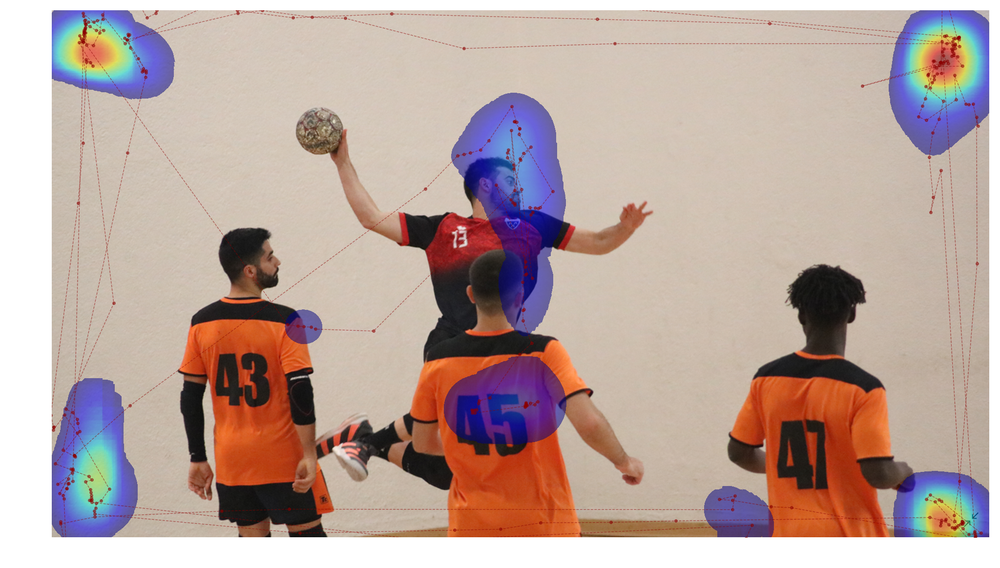

In [173]:
fixations_heatmap(df, (disp_w, disp_h), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)

In [148]:
gwh = gaussianwh
gsdwh = gwh / 6 if (gaussiansd is None) else gaussiansd
#
gaus = gaussian(gwh, gsdwh)
# matrix of zeroes
strt = gwh / 2
heatmapsize = (dispsize[0], dispsize[1])
heatmap = numpy.zeros(heatmapsize, dtype=float)
#print(np.shape(heatmap))

gazepoints = [(df_gazepoints.X.iloc[i], df_gazepoints.Y.iloc[i]) for i in range(len(df_gazepoints))]

In [149]:
gazepoints

[(970, 542),
 (972, 540),
 (970, 515),
 (970, 526),
 (941, 246),
 (946, 317),
 (933, 302),
 (933, 292),
 (935, 286),
 (962, 367),
 (984, 549),
 (910, 358),
 (940, 388),
 (948, 396),
 (948, 399),
 (944, 394),
 (959, 304),
 (966, 293),
 (981, 280),
 (960, 307),
 (946, 325),
 (948, 369),
 (659, 657),
 (540, 653),
 (531, 649),
 (516, 648),
 (504, 647),
 (483, 644),
 (71, 71),
 (70, 28),
 (67, 21),
 (69, 20),
 (65, 12),
 (64, 6),
 (106, 41),
 (91, 41),
 (78, 33),
 (69, 29),
 (69, 46),
 (67, 52),
 (66, 57),
 (65, 61),
 (64, 65),
 (62, 63),
 (57, 52),
 (60, 58),
 (127, 600),
 (29, 817),
 (43, 824),
 (52, 838),
 (53, 846),
 (57, 863),
 (7, 929),
 (76, 955),
 (82, 962),
 (69, 966),
 (79, 982),
 (80, 988),
 (81, 994),
 (81, 999),
 (82, 1003),
 (80, 1004),
 (77, 1004),
 (82, 1008),
 (767, 1086),
 (1434, 1055),
 (1422, 1082),
 (1463, 1088),
 (1512, 1094),
 (1555, 1102),
 (1903, 1129),
 (1743, 1105),
 (1825, 1102),
 (1847, 1099),
 (1860, 1096),
 (1866, 1091),
 (1883, 1115),
 (1908, 1139),
 (1903, 1

In [150]:
for i in range(0, len(gazepoints)):
    # get x and y coordinates
    x =  gazepoints[i][0] 
    #print(x)
    y =  gazepoints[i][1] 
    # add Gaussian to the current heatmap
    ####
    ####
    if (x>0) and (y>0):
        x_inf = x - (gwh/2)
        x_sup = x + (gwh/2)
        y_inf = y - (gwh/2)
        y_sup = y + (gwh/2)
        ####
        ####
        if x_inf<0:
            x_inf=0
        if x_sup>dispsize[0]:
            x_sup = dispsize[0]
        if y_inf<0:
            y_inf=0
        if y_sup>dispsize[1]:
            y_sup = dispsize[1]
        ####
        ####
        y_inf=int(y_inf)
        y_sup=int(y_sup)
        x_inf=int(x_inf)
        x_sup=int(x_sup)
        ##
        gaus = gaussian(x=x_sup-x_inf, y=y_sup-y_inf, sx=gsdwh)
        heatmap[x_inf:x_sup, y_inf:y_sup ] += gaus
###


C:\Users\David\Anaconda3\envs\python3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in less
  This is separate from the ipykernel package so we can avoid doing imports until


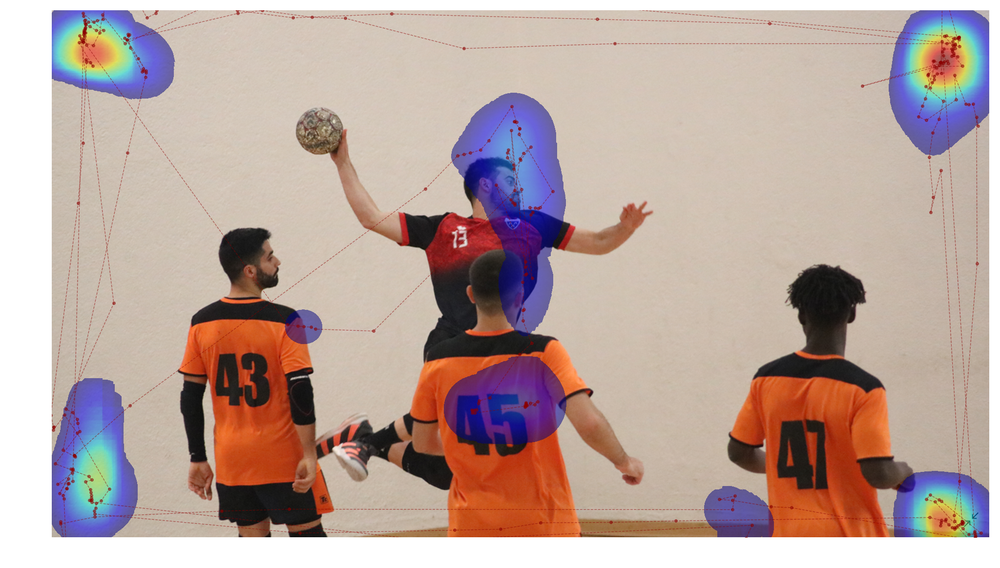

In [161]:
heatmap_low = heatmap.copy()
fig, ax = draw_display(dispsize, imagefile=imagefile)
lowbound = numpy.mean(heatmap[heatmap > 0])
heatmap_low[heatmap_low < lowbound] = numpy.NaN
# draw heatmap on top of image
ax.imshow(heatmap_low.T, cmap='jet', alpha=alpha) #, origin="lower")
plt.plot(df_gazepoints.X, df_gazepoints.Y, '--', color='darkred', alpha=0.5, marker='o', linewidth=1, markersize=4)
# FINISH PLOT
# invert the y axis, as (0,0) is top left on a display
ax.invert_yaxis()

In [160]:
np.shape(heatmap_low.T)

(1080, 1920)

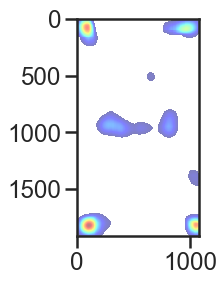

In [157]:
plt.imshow(heatmap_low, cmap='jet', alpha=alpha) #, origin="lower")


C:\Users\David\Anaconda3\envs\python3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in greater
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\David\Anaconda3\envs\python3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in less
  after removing the cwd from sys.path.


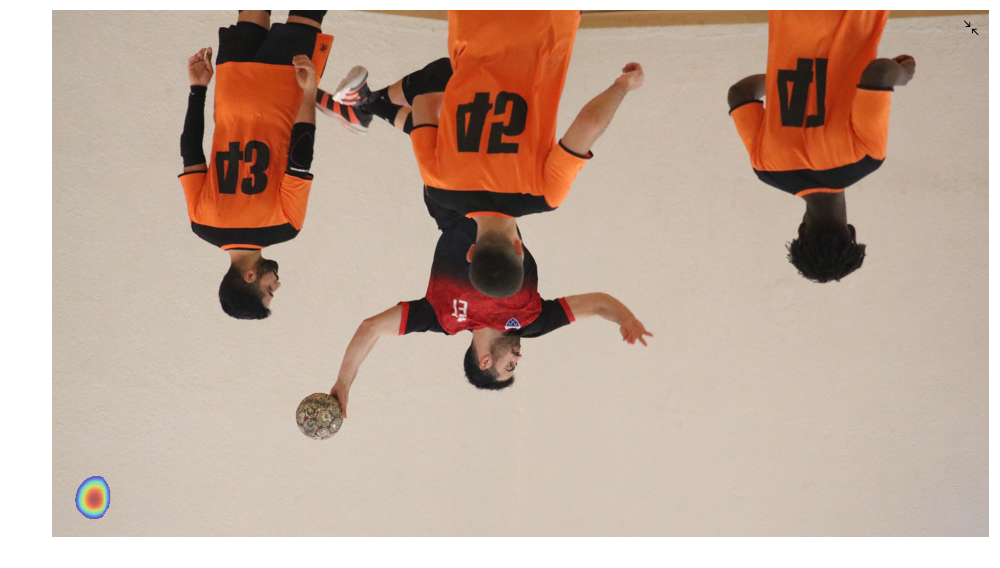

In [139]:
fig, ax = draw_display(dispsize, imagefile=imagefile)

lowbound = numpy.mean(heatmap[heatmap > 0])
heatmap[heatmap < lowbound] = numpy.NaN
# draw heatmap on top of image
ax.imshow(heatmap, cmap='jet', alpha=alpha, origin="lower")
#ax.invert_yaxis()

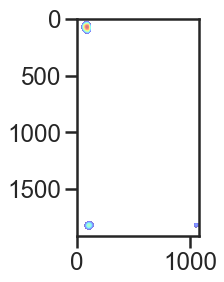

In [137]:
plt.imshow(heatmap, cmap='jet', alpha=alpha)


In [120]:
N = heatmap[x_inf:x_sup, y_inf:y_sup ]
np.shape(N)

(179, 198)

In [123]:
y_sup-y_inf

200

In [124]:
x_sup-x_inf

179

In [125]:
gaus = gaussian(x=x_sup-x_inf, y=y_sup-y_inf, sx=gsdwh)

In [126]:
np.shape(gaus)

(179, 200)

In [128]:
np.shape(heatmap[x_inf:x_sup, y_inf:y_sup ])

(179, 198)

In [129]:
np.shape(heatmap)

(1920, 1080)

In [130]:


y_sup

1082

In [115]:
np.shape(heatmap)

(1920, 1080)

In [110]:
AA = gaussian(x=20, y=100, sx=gsdwh)
np.shape(AA)
AA

array([[0.59452055, 0.59678402, 0.59881654, ..., 0.13348048, 0.12888948,
        0.12440661],
       [0.60640937, 0.60871811, 0.61079127, ..., 0.13614974, 0.13146692,
        0.1268944 ],
       [0.61828856, 0.62064253, 0.62275631, ..., 0.13881683, 0.13404228,
        0.12938019],
       ...,
       [0.78836035, 0.79136182, 0.79405703, ..., 0.17700098, 0.17091311,
        0.16496862],
       [0.79867594, 0.80171668, 0.80444716, ..., 0.17931702, 0.17314948,
        0.16712721],
       [0.80880292, 0.81188222, 0.81464732, ..., 0.1815907 , 0.17534497,
        0.16924634]])

In [98]:
gazepoints[i]

(1434, 1055)

In [99]:
np.shape(heatmap)

(2120, 1280)

ValueError: negative dimensions are not allowed

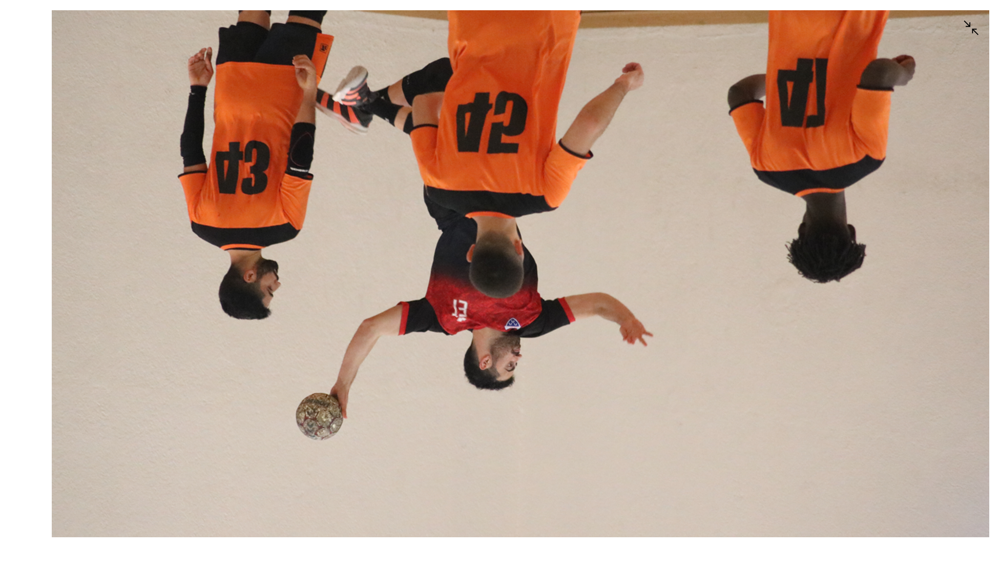

In [90]:
draw_heatmap(df, (disp_w, disp_h), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)

In [5]:
## File 1

#Load and get data
data = pd.read_csv(file1, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)


draw_heatmap(df, (display_width, display_height), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)


ValueError: operands could not be broadcast together with shapes (180,320,4) (1080,1920,3) (180,320,4) 

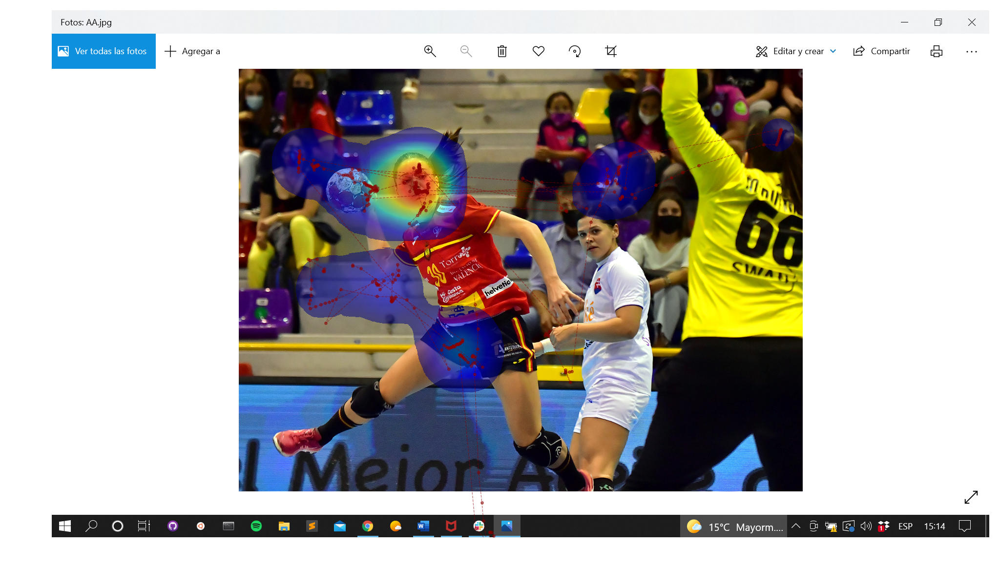

In [4]:
## File 2

#Load and get data
data = pd.read_csv(file2, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)


draw_heatmap(df, (display_width, display_height), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)


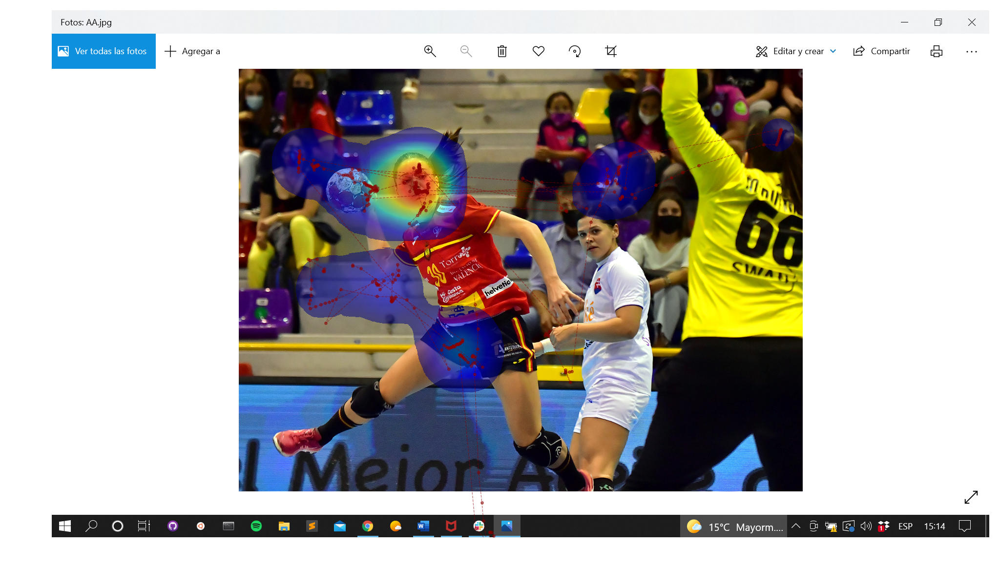

In [5]:
## File 3

#Load and get data
data = pd.read_csv(file3, delimiter=',', header=None)
df_ = data[data.iloc[:,2]=='statuscode:200']
df_ = df_.reset_index()


#Positions x y and times
pos_x = []
pos_y = []
time_ = []
for i in range(len(df_)):
    x = float(df_.iloc[:,4][i].split(':')[-1])
    pos_x.append(x)
    y = float(df_.iloc[:,5][i].split(':')[1].split('}')[0])
    pos_y.append(y)
    time = df_.iloc[:,-1][i].split(' ')[-1].split('}')[0].split('"')[0]
    time_.append(time)
    
df = pd.DataFrame({'x':pos_x, 'y':pos_y, 'time': time_})

#Remove 0s and convert to ints
df = df.loc[df['x']!=0]
df = df.loc[df['y']!=0]
df['X'] = df['x'].astype(int)
df['Y'] = df['y'].astype(int)


draw_heatmap(df, (display_width, display_height), alpha=alpha, savefilename=None, plot_xy=True, 
             imagefile=background_image, gaussianwh=ngaussian, gaussiansd=sd)
